# 第二次作业：频繁模式与关联规则挖掘
## 选用数据集：
+ [Wine Reviews](https://www.kaggle.com/zynicide/wine-reviews): 130k wine reviews with variety, location, winery, price, and description.

## 处理代码：
+ 对 [Wine Reviews](https://www.kaggle.com/zynicide/wine-reviews) 数据集，处理代码为：[wine-reviews-2.ipynb](./wine-reviews-2.ipynb)

## 作业要求：
+ 对数据集进行处理，转换成适合进行关联规则挖掘的形式
+ 找出频繁模式
+ 导出关联规则，支持其计算度和置信度
+ 对规则进行评价、可使用Lift、卡方和其他教材中提及的指标，至少两种
+ 对数据挖掘结果进行分析
+ 可视化展示

## 实现过程
### 1.数据预处理，转化为适合进行关联规则挖掘的形式

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from pymining import itemmining,assocrules

In [2]:
file_path_130 = '../Datasets/wine-reviews/winemag-data-130k-v2.csv'
df_130 = pd.read_csv(file_path_130, index_col=0)

 #### 简单显示数据格式

In [4]:
df_130.head(5)

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks


#### 去除不必要的属性、去除空缺值

In [6]:
df_130.drop('description',inplace=True, axis=1)
df_130.dropna(how='any',inplace=True)
df_130.isnull().sum()

country                  0
designation              0
points                   0
price                    0
province                 0
region_1                 0
region_2                 0
taster_name              0
taster_twitter_handle    0
title                    0
variety                  0
winery                   0
dtype: int64

#### 转化数据为合适数据挖掘的形式

In [9]:
df_130['points'] = pd.cut(df_130.points, bins=[79, 85, 90, 95, 100], labels=['80~85', '85~90', '90~95', '95~100'])
df_130['price'] = pd.cut(df_130.price, bins=[0, 16, 25, 50, 100, 2013], labels=['0~16', '16~25', '25~50', '50~100', '100+'])
transactions = np.array(df_130).tolist()

### 2.找出频繁模式


使用 Relim算法进行频繁模式挖掘

In [10]:
relim_input = itemmining.get_relim_input(transactions)
report = itemmining.relim(relim_input, min_support=88)

In [11]:
report_sort = sorted(report.items(), key=lambda item:item[1], reverse=True)
report_len = len(report_sort)
print('挖掘得到的频繁模式数量：{}'.format(report_len))

挖掘得到的频繁模式数量：19999



#### 展示频繁模式前20项
#### 展示结果：(item, number)对应挖掘得到的频繁模式的项目集，项目集出现频数

In [12]:
for item in report_sort[:20]:
    print(item)

(frozenset({'US'}), 22387)
(frozenset({'California'}), 12900)
(frozenset({'California', 'US'}), 12900)
(frozenset({'85~90'}), 11811)
(frozenset({'85~90', 'US'}), 11811)
(frozenset({'25~50'}), 10829)
(frozenset({'US', '25~50'}), 10829)
(frozenset({'90~95'}), 8631)
(frozenset({'90~95', 'US'}), 8631)
(frozenset({'85~90', 'California'}), 6453)
(frozenset({'85~90', 'California', 'US'}), 6453)
(frozenset({'@vboone'}), 6422)
(frozenset({'@vboone', 'Virginie Boone'}), 6422)
(frozenset({'@vboone', 'California', 'Virginie Boone'}), 6422)
(frozenset({'@vboone', 'California', 'US', 'Virginie Boone'}), 6422)
(frozenset({'@vboone', 'US', 'Virginie Boone'}), 6422)
(frozenset({'@vboone', 'California'}), 6422)
(frozenset({'@vboone', 'California', 'US'}), 6422)
(frozenset({'@vboone', 'US'}), 6422)
(frozenset({'Virginie Boone'}), 6422)


### 3.导出关联规则，支持其计算度和置信度

In [14]:
rules = assocrules.mine_assoc_rules(report, min_support=100, min_confidence=0.5)

In [15]:
# 打印 50 个挖掘到的关联规则
print_count = 50
count = 0
for item in rules:
    # 计算相对支持度
    sup = report[item[0]|item[1]] * 1.0 / report_len
    if count <= print_count:
        print("rules:\n{} ---> {} \nabsolute support:{}  support:{}  confidence:{}".format(str(item[0])[10:-1], str(item[1])[10:-1], item[2], round(sup, 4), round(item[3], 4)))
        print(72 * '-')
    count += 1

rules:
{'@paulgwine\xa0', 'US', 'Dundee Hills', 'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', '50~100'} ---> {'Willamette Valley'} 
absolute support:126  support:0.0063  confidence:1.0
------------------------------------------------------------------------
rules:
{'US', 'Dundee Hills', 'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', '50~100'} ---> {'Willamette Valley', '@paulgwine\xa0'} 
absolute support:126  support:0.0063  confidence:1.0
------------------------------------------------------------------------
rules:
{'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', 'Dundee Hills', '50~100'} ---> {'Willamette Valley', '@paulgwine\xa0', 'US'} 
absolute support:126  support:0.0063  confidence:1.0
------------------------------------------------------------------------
rules:
{'Oregon', 'Paul Gregutt', '90~95', 'Dundee Hills', '50~100'} ---> {'Pinot Noir', 'Willamette Valley', '@paulgwine\xa0', 'US'} 
absolute support:126  support:0.0063  confidence:0.8129
--------------------------

### 4.对规则进行评价、可使用Lift、卡方和其他教材中提及的指标，至少两种

In [16]:
# 对规则评价，评价标准为Lift、all_confidence、Kulc、cosine，并输出出来
print_count = 50
count = 0
# 得到的数据进行整理，方便后续可视化
result = []
for item in rules:
    # 计算相对支持度
    sup = report[item[0]|item[1]] * 1.0 / report_len
    # 计算item_1支持度
    sup_1 = report[item[0]] * 1.0 / report_len
    # 计算item_2支持度
    sup_2 = report[item[1]] * 1.0 / report_len
    # Lift 度量
    lift = sup / (sup_1 * sup_2)
    # all_confidence 度量
    all_confidence = sup / max(sup_1, sup_2)
    # Kulc 度量
    kulc = (sup / sup_1 + sup / sup_2) / 2
    # cosine 度量
    cosine = sup / np.sqrt(sup_1 * sup_2)
    result.append([str(item[0])[10:-1] + "--->" + str(item[1])[10:-1], sup, item[3], lift, all_confidence, kulc, cosine])
    if count <= print_count:
        print("rules:\n{} ---> {} \nlift:{}  all_confidence:{}  kulc:{}  cosine:{}".format(str(item[0])[10:-1], str(item[1])[10:-1], round(lift, 4), round(all_confidence, 4), round(kulc, 4), round(cosine, 4)))
        print(72 * '-')
    count += 1

rules:
{'@paulgwine\xa0', 'US', 'Dundee Hills', 'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', '50~100'} ---> {'Willamette Valley'} 
lift:7.6831  all_confidence:0.0484  kulc:0.5242  cosine:0.22
------------------------------------------------------------------------
rules:
{'US', 'Dundee Hills', 'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', '50~100'} ---> {'Willamette Valley', '@paulgwine\xa0'} 
lift:7.7878  all_confidence:0.0491  kulc:0.5245  cosine:0.2215
------------------------------------------------------------------------
rules:
{'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', 'Dundee Hills', '50~100'} ---> {'Willamette Valley', '@paulgwine\xa0', 'US'} 
lift:7.7878  all_confidence:0.0491  kulc:0.5245  cosine:0.2215
------------------------------------------------------------------------
rules:
{'Oregon', 'Paul Gregutt', '90~95', 'Dundee Hills', '50~100'} ---> {'Pinot Noir', 'Willamette Valley', '@paulgwine\xa0', 'US'} 
lift:8.7925  all_confidence:0.0681  kulc:0.4405  cosin

### 5.对数据挖掘结果进行分析

In [18]:
# 转化为DataFrame格式
res = pd.DataFrame(data=result, columns=['rule', 'support', 'confidence', 'lift', 'all_confidence', 'kulc', 'cosine'])
# 对list进行降序排序
res_sort = res.sort_values(by=['lift'], ascending=False)
res_sort = res_sort.reset_index()
res_sort.drop(['index'], inplace=True, axis=1)

In [19]:
# 展示置信度最高的前20项关联规则
res_sort_confidence = res.sort_values(by=['confidence'], ascending=False)
res_sort_confidence.reset_index(inplace=True)
res_50_rule = np.array(res_sort_confidence.loc[:20, 'rule']).tolist()
for item in res_50_rule:
    print(item)

{'@paulgwine\xa0', 'US', 'Dundee Hills', 'Pinot Noir', 'Oregon', 'Paul Gregutt', '90~95', '50~100'}--->{'Willamette Valley'}
{'@paulgwine\xa0', 'Columbia Valley (WA)', '90~95', 'Washington', '25~50'}--->{'Paul Gregutt'}
{'@paulgwine\xa0', 'Columbia Valley (WA)', '90~95', 'Washington'}--->{'Paul Gregutt', 'US'}
{'@paulgwine\xa0', 'Columbia Valley (WA)', 'Paul Gregutt', '90~95', 'Washington'}--->{'US'}
{'US', 'Columbia Valley (WA)', 'Paul Gregutt', '90~95'}--->{'@paulgwine\xa0', 'Washington'}
{'Paul Gregutt', '90~95', 'Columbia Valley (WA)'}--->{'@paulgwine\xa0', 'US', 'Washington'}
{'Columbia Valley (WA)', 'Paul Gregutt', '90~95', 'Washington'}--->{'@paulgwine\xa0', 'US'}
{'US', 'Columbia Valley (WA)', 'Paul Gregutt', '90~95', 'Washington'}--->{'@paulgwine\xa0'}
{'@paulgwine\xa0', 'Columbia Valley (WA)', 'Paul Gregutt', '90~95', '25~50'}--->{'Washington'}
{'@paulgwine\xa0', 'Columbia Valley (WA)', '90~95', '25~50'}--->{'Paul Gregutt', 'Washington'}
{'Columbia Valley (WA)', 'Paul Gregutt

In [21]:
low_count = 0
mid_count = 0
high_count = 0
for i in range(len(res)):
    if res.iat[i, 3] > 1.0:
        high_count += 1
    elif res.iat[i, 3] < 1.0:
        low_count += 1
    else:
        mid_count +=1
print('关联规则一共有:',len(res))
print('Lift > 1的关联规则有:',high_count)
print('Lift < 1的关联规则有：',low_count)
print('Lift = 1的关联规则有：',mid_count)


关联规则一共有: 159217
Lift > 1的关联规则有: 147687
Lift < 1的关联规则有： 11530
Lift = 1的关联规则有： 0


### 6.可视化展示

支持度, 置信度散点图绘制 （支持度在0～0.5间、置信度在0.5-1间）

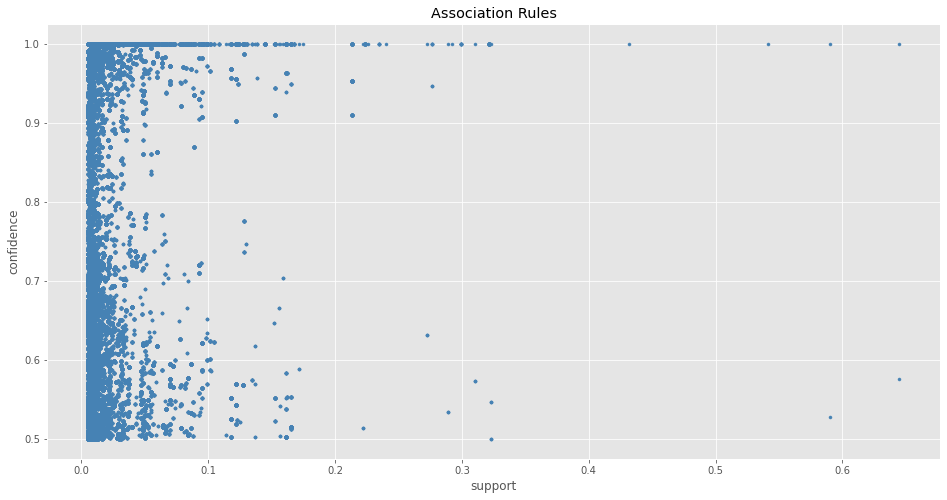

In [23]:
plt.figure(figsize=(16,8))
plt.style.use('ggplot')

plt.scatter(x=res['support'], y=res['confidence'], marker='.',color = 'steelblue')

plt.title('Association Rules')
plt.xlabel('support')
plt.ylabel('confidence')
plt.show()

In [ ]:
通过条形图来可视化关联规则的对应的支持度，选择排名靠前80进行展示

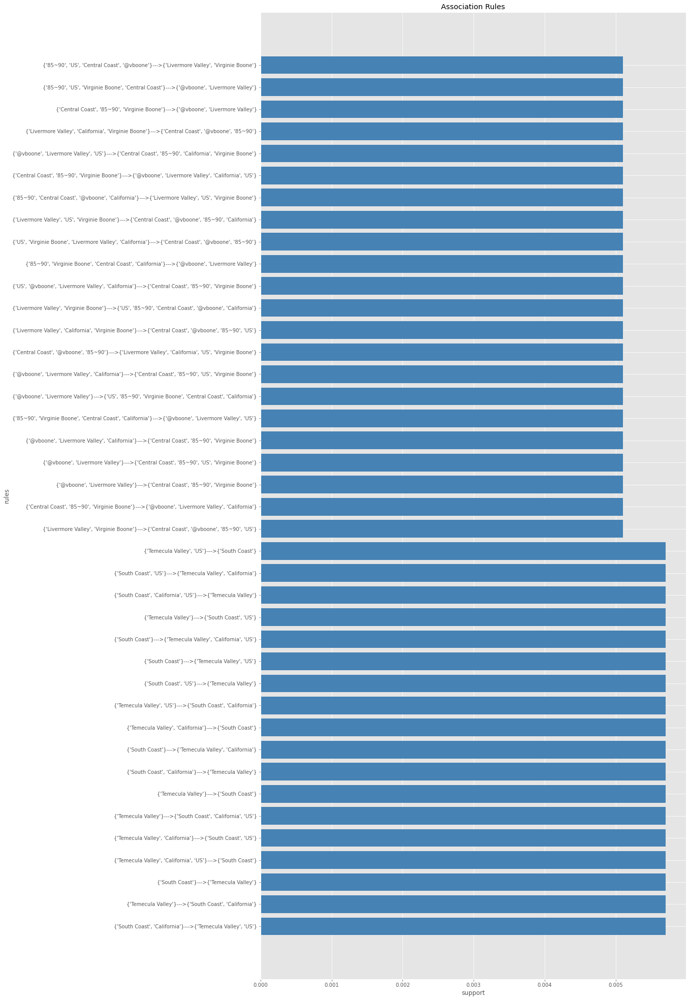

In [26]:
plt.figure(figsize=(15, 35))
plt.style.use('ggplot')

x = [i for i in range(40)]
y = res_sort.loc[:39, 'support'].tolist()
xticks = res_sort.loc[:39, 'rule'].tolist()
plt.yticks(x, xticks)
plt.barh(x, y, color = 'steelblue')

plt.title('Association Rules')
plt.ylabel('rules')
plt.xlabel('support')
plt.show()

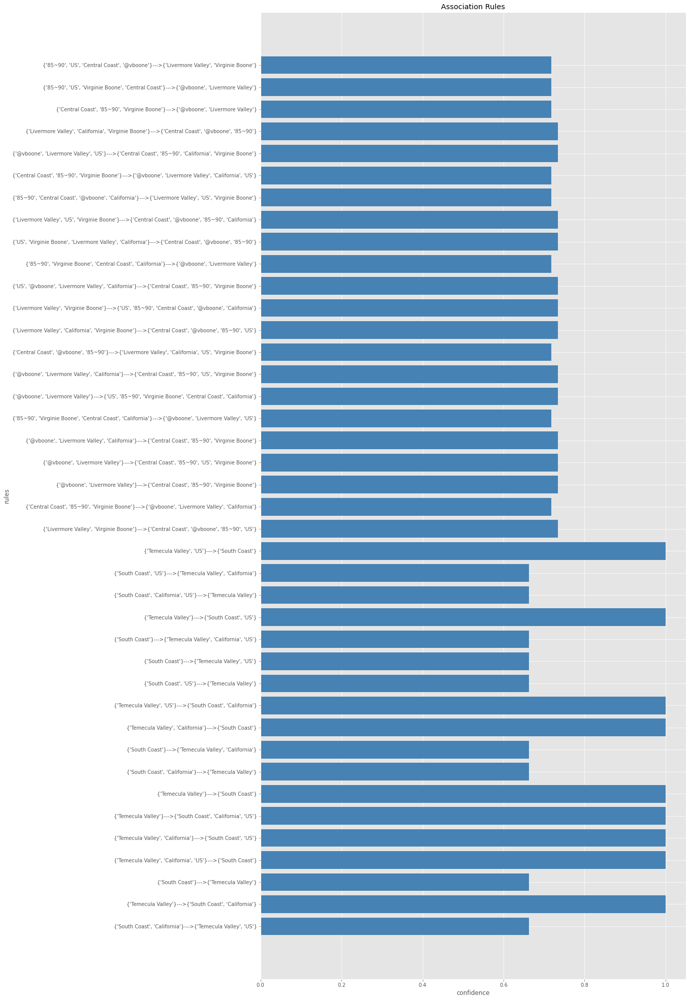

In [27]:
plt.figure(figsize=(15, 35))
plt.style.use('ggplot')

x = [i for i in range(40)]
y = res_sort.loc[:39, 'confidence'].tolist()
xticks = res_sort.loc[:39, 'rule'].tolist()
plt.yticks(x, xticks)
plt.barh(x, y, color = 'steelblue')

plt.title('Association Rules')
plt.ylabel('rules')
plt.xlabel('confidence')
plt.show()